# Monthly Project : EDA
## 1. 서울 공공자전거 대여이력 분석

In [1]:
import pandas as pd
import numpy as np
import missingno
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns

%matplotlib inline

In [2]:
# 2021년 1월 자전거 대여이력 정보(서울시 공공데이터)를 사용한다.
rent = pd.read_csv('rent_1.csv')
rent.shape

(806503, 11)

In [3]:
rent.head(5)

,자전거번호,대여일시,대여 대여소번호,대여 대여소명,대여거치대,반납일시,반납대여소번호,반납대여소명,반납거치대,이용시간,이용거리
0,SPB-53145,2021-01-02 20:50:36,3,중랑센터,0,2021-01-02 21:15:41,668,서울축산농협(장안지점),0,25,0.00
1,SPB-53074,2021-01-04 16:02:12,3,중랑센터,0,2021-01-04 16:17:06,668,서울축산농협(장안지점),0,14,0.00
2,SPB-50952,2021-01-13 21:02:05,3,중랑센터,0,2021-01-13 21:14:04,668,서울축산농협(장안지점),0,11,1853.99
3,SPB-52380,2021-01-14 21:02:55,3,중랑센터,0,2021-01-14 21:13:41,668,서울축산농협(장안지점),0,10,0.00
4,SPB-52380,2021-01-18 18:02:08,3,중랑센터,0,2021-01-18 18:15:22,540,군자역 7번출구 베스트샵 앞,0,13,2291.05


In [4]:
# 결측치 확인 결과 모든 column에서 결측치가 발견되지 않았다.
rent.isnull().sum()

자전거번호       0
대여일시        0
대여 대여소번호    0
대여 대여소명     0
대여거치대       0
반납일시        0
반납대여소번호     0
반납대여소명      0
반납거치대       0
이용시간        0
이용거리        0
dtype: int64

In [13]:
# 한글폰트 없이 사용 시 matplotlib에서 오류가 발생하게 된다.
# 한글폰트를 미리 적용시켜준다.
# 이 때, 미리 폰트를 설치하고 가상환경의 matplotlib의 폰트 경로에 폰트를 복사해주고,
# 커널을 재시작해야 한다.
# 아래 코드로 제대로 설치되었는지 확인할 수 있다.
# 다음 블로그 글을 참고할 것: https://dsstudy.tistory.com/15

# import matplotlib    
# import matplotlib.font_manager
# [f.name for f in matplotlib.font_manager.fontManager.ttflist if 'Nanum' in f.name]
plt.rcParams['font.family'] = 'NanumGothic'

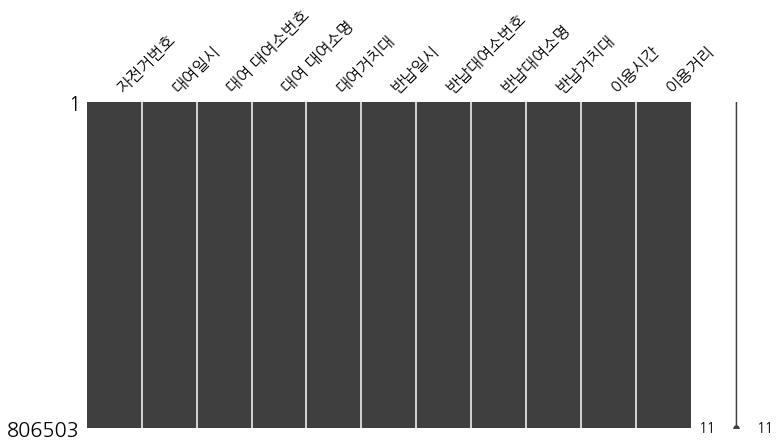

In [19]:
# 결측치 시각화를 위한 라이브러리 missingno를 사용한다.
missingno.matrix(rent, figsize=(12,6))
plt.show()

In [15]:
# 수치형 자료 중 의미있는 column만을 선택하여 통계량 확인
# 1회 대여시의 평균적인 이용거리, 이용시간을 확인할 수 있다.
# 평균 2780m를 이동하며, 이용시간은 25분 가량이다.
rent[['이용거리', '이용시간']].describe()

,이용거리,이용시간
count,806503.000000,806503.00000
mean,2783.126334,25.69352
std,3558.647413,28.53219
min,0.000000,1.00000
25%,759.320000,7.00000
50%,1596.080000,15.00000
75%,3355.420000,34.00000
max,93737.660000,1589.00000


In [16]:
# 객체타입의 데이터를 다루고 싶을 경우, include object 설정을 추가한다.
# unique한 데이터의 수, 가장 많이 출현한 데이터와 그 출현횟수에 대한 정보가 추가된다.
# 2021년 1월 가장 많이 대여된 대여소는 여의나루역이며, 뚝섬유원지역에서 반납된 경우가 가장 많다.
# 80여만건 중 한 개의 대여소에서 최대 2600여건이 각각 대여되고, 최대 3100여건이 반납되었다.
rent.describe(include=object)

,자전거번호,대여일시,대여 대여소명,반납일시,반납대여소명
count,806503,806503,806503,806503,806503
unique,18945,623499,2186,623142,2183
top,SPB-53496,2021-01-25 18:08:18,여의나루역 1번출구 앞,2021-01-23 18:07:29,뚝섬유원지역 1번출구 앞
freq,166,9,2592,8,3091


In [22]:
# 대여/반납 대여소의 수
print(rent['대여 대여소명'].nunique())
print(rent['반납대여소명'].nunique())

2186
2183


In [32]:
print('대여량 많은 대여소 TOP 5 \n\n', rent['대여 대여소명'].value_counts().head(5), end='\n\n\n')
print('반납량 많은 대여소 TOP5 \n\n', rent['반납대여소명'].value_counts().head(5))

대여량 많은 대여소 TOP 5 

 여의나루역 1번출구 앞         2592
뚝섬유원지역 1번출구 앞        2554
봉림교 교통섬              2345
롯데월드타워(잠실역2번출구 쪽)    2076
마곡나루역 2번 출구          2016
Name: 대여 대여소명, dtype: int64


반납량 많은 대여소 TOP5 

 뚝섬유원지역 1번출구 앞        3091
여의나루역 1번출구 앞         2676
봉림교 교통섬              2405
마포구민체육센터 앞           2260
롯데월드타워(잠실역2번출구 쪽)    2084
Name: 반납대여소명, dtype: int64


- 주로 강을 끼고 있는 지역의 대여량 및 반납량이 많았다. 해당 자료가 2021년 1월로 기온이 낮은 겨울철임을 고려할 때, 봄~가을에 걸쳐서 강 주변의 대여소에서의 대여 및 반납이 더욱 활발할 것이라 예측할 수 있다.

### 일별 변화량의 측정

In [36]:
# 데이터 타입을 변경하여 시간 정보를 더욱 적극적으로 활용할 수 있도록 만든다.
rent['대여일시'] = pd.to_datetime(rent['대여일시'])
rent['반납일시'] = pd.to_datetime(rent['반납일시'])
rent.dtypes

자전거번호               object
대여일시        datetime64[ns]
대여 대여소번호             int64
대여 대여소명             object
대여거치대                int64
반납일시        datetime64[ns]
반납대여소번호              int64
반납대여소명              object
반납거치대                int64
이용시간                 int64
이용거리               float64
dtype: object

In [45]:
# 1월에 한정된 자료이므로, 일별 대여 추이를 확인하기 위해 day 단위로 분리해본다.
rent['대여일'] = rent['대여일시'].dt.day
rent['반납일'] = rent['반납일시'].dt.day
rent['대여일'].head(5)

0     2
1     4
2    13
3    14
4    18
Name: 대여일, dtype: int64

In [99]:
# 1월의 일별 자전거 대여량 변화 추이
# 각 대여일 별로 수를 count하고, index를 따로 지정해주기 위해 reset한다.
# 대여와 반납을 구분하여 보기 위해서, 구분 column을 새롭게 만들어 값을 부여한다.
# 전체 데이터를 day에 따라 정렬하고, 두 구분/반납 데이터프레임을 합친다.
rent_by_date = rent['대여일'].value_counts().reset_index()
rent_by_date.columns = ['day', 'count']
rent_by_date = rent_by_date.sort_values('day')
rent_by_date['구분'] = '대여'

return_by_date = rent['반납일'].value_counts().reset_index()
return_by_date.columns = ['day', 'count']
return_by_date = return_by_date.sort_values('day')
return_by_date['구분'] = '반납'

bike_by_date = pd.concat([rent_by_date, return_by_date])
bike_by_date

,day,count,구분
18,1,22119,대여
15,2,23463,대여
20,3,21656,대여
7,4,32732,대여
10,5,28819,대여
...,...,...,...
2,27,45355,반납
16,28,22813,반납
14,29,24150,반납
11,30,28075,반납


In [118]:
# 일평균 26016회의 대여 및 반납이 이루어졌다.
bike_by_date[bike_by_date['구분'] == '대여']['count'].mean()
bike_by_date[bike_by_date['구분'] == '반납']['count'].mean()

26016.225806451614

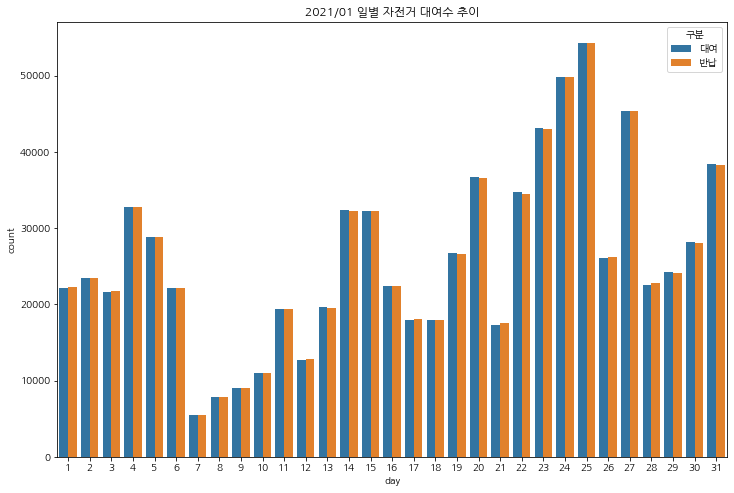

In [73]:
# 위 테이블을 시각화한다
plt.figure(figsize=(12, 8))
sns.barplot(data=bike_by_date, x='day', y='count', hue='구분')
plt.title('2021/01 일별 자전거 대여수 추이')
plt.show()

- 월별 데이터라면 계절에 따라 유의미한 차이가 있었겠지만, 겨울철 한 달 동안의 변화량은 큰 의미를 찾기 어렵다. 그러나 당시의 기후 데이터와 비교한다면 기온 및 기상 상태에 따른 대여량의 변화에 대해서는 파악할 수 있으리라 생각된다. 물론 이는 매우 상식적인 결과이기 때문에 굳이 데이터를 통한 증명이 필요하리라 생각되지는 않는다.

### 요일별 변화량의 측정

In [74]:
# 요일에 대한 데이터는 당장 존재하기 않기 때문에, 이를 구분할 수 있는 새로운 데이터를 생성한다.
rent['대여요일'] = rent['대여일시'].dt.dayofweek
rent['반납요일'] = rent['반납일시'].dt.dayofweek

In [76]:
# 일별 데이터 측정 시에 진행한 것과 같이, 테이블의 구성을 변경하고 대여반납 구분을 추가한다.
rent_by_wd = rent['대여요일'].value_counts().reset_index()
rent_by_wd.columns = ['day_of_week', 'count']
rent_by_wd = rent_by_wd.sort_values('day_of_week')
rent_by_wd['구분'] = '대여'

return_by_wd = rent['반납요일'].value_counts().reset_index()
return_by_wd.columns = ['day_of_week', 'count']
return_by_wd = return_by_wd.sort_values('day_of_week')
return_by_wd['구분'] = '반납'

bike_by_wd = pd.concat([rent_by_wd, return_by_wd])
bike_by_wd

,day_of_week,count,구분
2,0,124405,대여
5,1,94330,대여
3,2,123854,대여
6,3,77773,대여
4,4,121210,대여
1,5,126175,대여
0,6,138756,대여
2,0,124562,반납
5,1,94583,반납
3,2,123672,반납


In [78]:
# 요일을 문자열로 구분시킨다
wd_map = {0: '월', 1:'화', 2:'수',3:'목',4:'금',5:'토',6:'일'}
bike_by_wd['weekday'] = bike_by_wd['day_of_week'].apply(lambda x: wd_map[x])

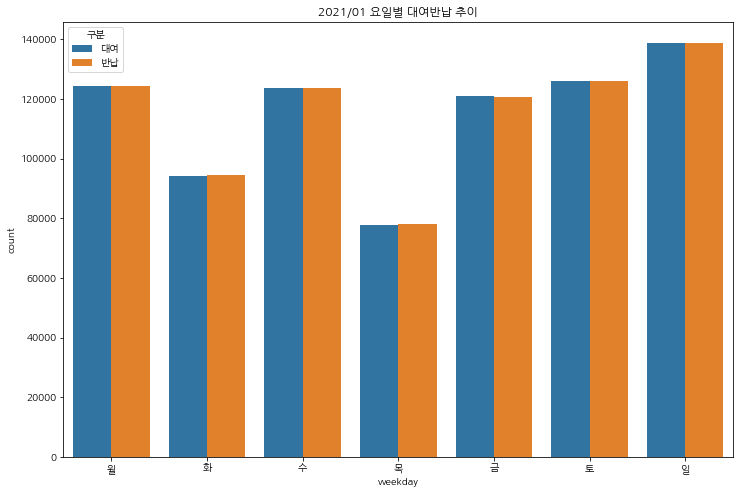

In [79]:
# 시각화
plt.figure(figsize=(12, 8))
sns.barplot(data=bike_by_wd, x='weekday', y='count', hue='구분')
plt.title('2021/01 요일별 대여반납 추이')
plt.show()

- 매우 유의미한 차이를 찾기에는 어렵다. 주말이 기본적으로 대여량이 많다고 볼 수는 있으나, 만약 이 데이터가 1년 내지 반년을 포함한 데이터라면 좀 더 유의미하고 극명한 결과가 나타날 것이라 생각된다. 만약 따릉이의 주요 사용자가 청소년 및 대학생이라면, 이들의 방학 기간에 해당하는 1월은 주말과 평일의 차이가 비교적 적게 나타날 것이라 예측이 가능하다. 따라서 이후 이용자 데이터를 추가적으로 분석한다면 더욱 좋은 추론이 가능할 것이라 추측된다.

### 시간별 대여/반납 추이

In [80]:
# 앞서 진행한 과정을 동일하게 유지하도록 한다.
rent['대여시'] = rent['대여일시'].dt.hour
rent['반납시'] = rent['반납일시'].dt.hour

In [84]:
rent_by_hour = rent['대여시'].value_counts().reset_index()
rent_by_hour.columns = ['hour', 'count']
rent_by_hour = rent_by_hour.sort_values('hour')
rent_by_hour['구분'] = '대여'

return_by_hour = rent['반납시'].value_counts().reset_index()
return_by_hour.columns = ['hour', 'count']
return_by_hour = return_by_hour.sort_values('hour')
return_by_hour['구분'] = '반납'

bike_by_hour = pd.concat([rent_by_hour, return_by_hour])

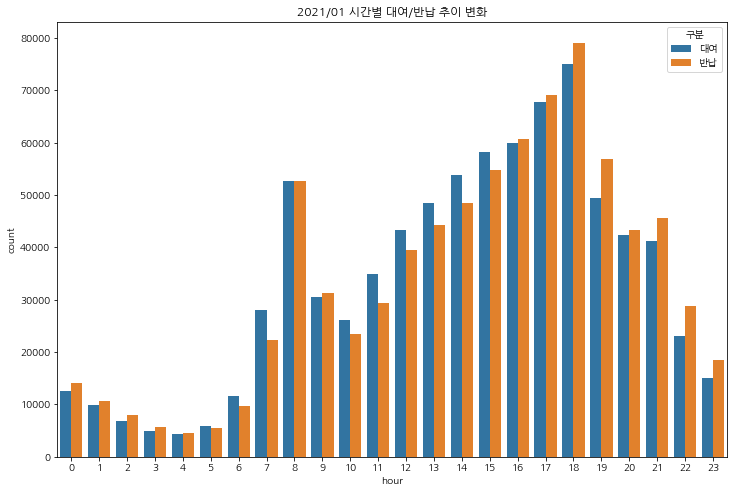

In [85]:
plt.figure(figsize=(12,8))
sns.barplot(data=bike_by_hour, x="hour", y="count", hue="구분")
plt.title('2021/01 시간별 대여/반납 추이 변화')
plt.show()

- 아침 출근 시간 / 점심 식사 후부터 저녁 식사 전 / 퇴근 시간 으로 이어지는 대여량 증가의 변화가 나타난다.
- 시간대별로 이용자의 정보(신분)가 달라질 것이라고 예상된다. 오전 11시~오후 6시 사이의 이용자는 청소년/대학생/주부 등이 많을 것이며, 출퇴근 시간대에는 직장인들이 상당량을 차지할 것으로 보인다.

## 2. 서울시 공공자전거 대여소 정보 분석

In [120]:
stations = pd.read_csv('bike_stations.csv')
stations.head(5)

,대여소번호,보관소(대여소)명,자치구,상세주소,위도,경도,설치시기,LCD대수,QR대수,운영방식
0,301,경복궁역 7번출구 앞,종로구,서울특별시 종로구 사직로 지하130,37.575794,126.971451,2015-10-07,16.0,NaN,LCD
1,302,경복궁역 4번출구 뒤,종로구,서울특별시 종로구 사직로 지하130,37.575947,126.974060,2015-10-07,12.0,NaN,LCD
2,303,광화문역 1번출구 앞,종로구,서울특별시 종로구 세종대로 지하189,37.571770,126.974663,2015-10-07,8.0,NaN,LCD
3,304,광화문역 2번출구 앞,종로구,서울특별시 종로구 세종대로 지하172,37.572113,126.977577,2021-01-26,NaN,7.0,QR
4,305,종로구청 옆,종로구,서울특별시 종로구 삼봉로 43,37.572582,126.978355,2015-10-07,16.0,NaN,LCD


In [128]:
# 거치대수 결측치를 0으로 만들고 이를 합쳐준다
stations = stations.fillna(0)
stations['거치대수'] = stations['LCD대수'] + stations['QR대수']
stations = stations.astype({'거치대수': 'int'})
stations.head(5)

,대여소번호,보관소(대여소)명,자치구,상세주소,위도,경도,설치시기,LCD대수,QR대수,운영방식,거치대수
0,301,경복궁역 7번출구 앞,종로구,서울특별시 종로구 사직로 지하130,37.575794,126.971451,2015-10-07,16.0,0.0,LCD,16
1,302,경복궁역 4번출구 뒤,종로구,서울특별시 종로구 사직로 지하130,37.575947,126.974060,2015-10-07,12.0,0.0,LCD,12
2,303,광화문역 1번출구 앞,종로구,서울특별시 종로구 세종대로 지하189,37.571770,126.974663,2015-10-07,8.0,0.0,LCD,8
3,304,광화문역 2번출구 앞,종로구,서울특별시 종로구 세종대로 지하172,37.572113,126.977577,2021-01-26,0.0,7.0,QR,7
4,305,종로구청 옆,종로구,서울특별시 종로구 삼봉로 43,37.572582,126.978355,2015-10-07,16.0,0.0,LCD,16


In [161]:
# 구별 거치대 수 분류 및 카운트
# 주로 강 근처 지역들이 거치대가 많이 설치되어 있다
stations_by_ward = stations.groupby(['자치구'])['거치대수'].sum()
stations_by_ward = stations_by_ward.reset_index()
stations_by_ward.columns = ['자치구', '총 거치대 수']
stations_by_ward = stations_by_ward.sort_values(by='총 거치대 수', ascending=False)
stations_by_ward

,자치구,총 거치대 수
17,송파구,1720
3,강서구,1677
14,서초구,1591
0,강남구,1482
19,영등포구,1475
12,마포구,1283
1,강동구,1152
6,구로구,1136
8,노원구,1131
22,종로구,1125


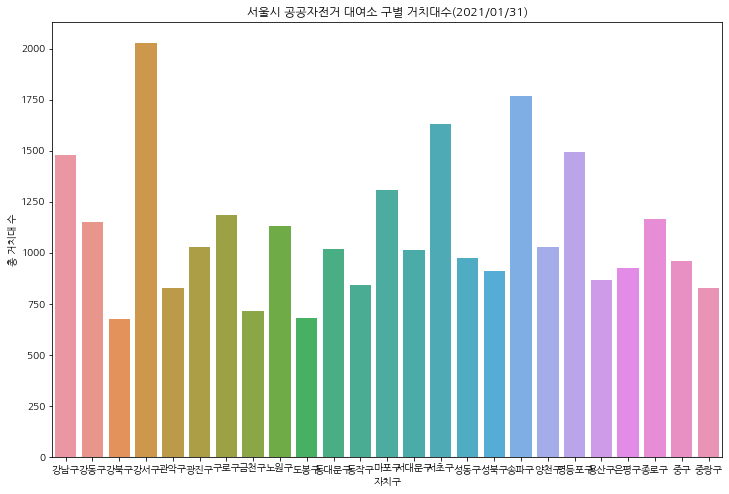

In [139]:
# 구별 거치대 수 시각화
plt.figure(figsize=(12, 8))
sns.barplot(data=stations_by_ward, x='자치구', y='총 거치대 수')
plt.title('서울시 공공자전거 대여소 구별 거치대수(2021/01/31)')
plt.show()

In [93]:
# 이제 사용하지 않을 설치 시기 및 운영 방식/거치대 수 column은 제거해준다.
stations = stations.drop(['설치시기', 'LCD대수', 'QR대수', '운영방식'], axis='columns')
stations.head(5)

,대여소번호,보관소(대여소)명,자치구,상세주소,위도,경도
0,301,경복궁역 7번출구 앞,종로구,서울특별시 종로구 사직로 지하130,37.575794,126.971451
1,302,경복궁역 4번출구 뒤,종로구,서울특별시 종로구 사직로 지하130,37.575947,126.974060
2,303,광화문역 1번출구 앞,종로구,서울특별시 종로구 세종대로 지하189,37.571770,126.974663
3,304,광화문역 2번출구 앞,종로구,서울특별시 종로구 세종대로 지하172,37.572113,126.977577
4,305,종로구청 옆,종로구,서울특별시 종로구 삼봉로 43,37.572582,126.978355


In [150]:
# 위에서 결측치를 0으로 대체했기 때문에, 위도/경도에 0값으로 채워진 행이 존재한다
# 위도, 경도값이 0에 해당하는 행을 삭제해준다
# 제거 결과 약 100여개 행이 사라졌다.
stations = stations[stations['위도'] != 0]
stations.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2042 entries, 0 to 2153
Data columns (total 11 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   대여소번호      2042 non-null   int64  
 1   보관소(대여소)명  2042 non-null   object 
 2   자치구        2042 non-null   object 
 3   상세주소       2042 non-null   object 
 4   위도         2042 non-null   float64
 5   경도         2042 non-null   float64
 6   설치시기       2042 non-null   object 
 7   LCD대수      2042 non-null   float64
 8   QR대수       2042 non-null   float64
 9   운영방식       2042 non-null   object 
 10  거치대수       2042 non-null   int64  
dtypes: float64(4), int64(2), object(5)
memory usage: 191.4+ KB


In [158]:
# 전체 대여소의 위치를 지도로 시각화
# 위 분석에서 강 근처의 지역에서 거치대가 많았으나,
# 실제 대여소의 분포로는 생각보다 균일하게 분산되어있는 것으로 보인다
# 이는 강 근처의 대여소들이 더 많은 거치대가 설치되어 있는 것이리라 생각된다.
import folium

map = folium.Map(location=[stations['위도'].mean(), stations['경도'].mean()], zoom_start=12)
for n in stations.index:    
    folium.Circle(
        location=[stations['위도'][n], stations['경도'][n]],
        radius=20,
        color='green',
        fill=True,
        fill_color='green'
    ).add_to(map)
map

In [172]:
# 대여소별로 대여 및 반납 횟수를 파악하고 싶다
# 대여소번호를 기준으로 위의 이용내역 데이터와 대여소 데이터를 병합할 것이다.
rent_counts = rent['대여 대여소번호'].value_counts()
return_counts = rent['반납대여소번호'].value_counts()

rent_counts = rent_counts.reset_index()
return_counts = return_counts.reset_index()

rent_counts.columns = ['대여소번호', '대여횟수']
return_counts.columns = ['대여소번호', '반납횟수']

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2185 entries, 0 to 2184
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   대여소번호   2185 non-null   int64
 1   반납횟수    2185 non-null   int64
dtypes: int64(2)
memory usage: 34.3 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2188 entries, 0 to 2187
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   대여소번호   2188 non-null   int64
 1   대여횟수    2188 non-null   int64
dtypes: int64(2)
memory usage: 34.3 KB


In [175]:
# 우선 대여소번호 당 대여횟수, 반납횟수를 하나의 테이블로 만들어준다
stations_counts = pd.merge(rent_counts, return_counts, on='대여소번호')
stations_counts

,대여소번호,대여횟수,반납횟수
0,207,2592,2676
1,502,2554,3091
2,2102,2345,2405
3,1210,2076,2084
4,2715,2016,1989
...,...,...,...
2180,1007,8,7
2181,3527,7,5
2182,2536,5,9
2183,2539,2,2


In [180]:
# 위에서 만든 테이블과 대여소 자료를 병합해준다.
stations = pd.merge(stations, stations_counts, on='대여소번호')
stations

,대여소번호,보관소(대여소)명,자치구,상세주소,위도,경도,설치시기,LCD대수,QR대수,운영방식,거치대수,대여횟수,반납횟수
0,301,경복궁역 7번출구 앞,종로구,서울특별시 종로구 사직로 지하130,37.575794,126.971451,2015-10-07,16.0,0.0,LCD,16,413,333
1,302,경복궁역 4번출구 뒤,종로구,서울특별시 종로구 사직로 지하130,37.575947,126.974060,2015-10-07,12.0,0.0,LCD,12,711,721
2,303,광화문역 1번출구 앞,종로구,서울특별시 종로구 세종대로 지하189,37.571770,126.974663,2015-10-07,8.0,0.0,LCD,8,587,590
3,304,광화문역 2번출구 앞,종로구,서울특별시 종로구 세종대로 지하172,37.572113,126.977577,2021-01-26,0.0,7.0,QR,7,391,405
4,305,종로구청 옆,종로구,서울특별시 종로구 삼봉로 43,37.572582,126.978355,2015-10-07,16.0,0.0,LCD,16,508,542
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025,1085,래미안 솔베뉴(고덕로),강동구,양재대로1650,37.554569,127.145874,2020-01-13,0.0,20.0,QR,20,173,132
2026,1086,래미안 솔베뉴(구천면로),강동구,양재대로1650,37.550598,127.145454,2020-01-10,0.0,10.0,QR,10,141,140
2027,1088,풍납사거리(강동),강동구,성내동451-3,37.528122,127.119522,2020-01-14,0.0,12.0,QR,12,212,218
2028,1089,고덕 래미안힐스테이트(201동),강동구,고덕동 675,37.560600,127.146698,2020-01-13,0.0,10.0,QR,10,52,53


In [218]:
# 자치구를 기준으로 대여 및 반납 횟수를 확인해본다
# 기본적으로 대여가 많이 발생하는 곳에서 반납도 많이 발생한다.
# 이는 결국 한 번의 대여 시 이동하는 반경이 자치구의 범위를 크게 벗어나지 않는다는 의미이다.
rent_by_ward = stations.groupby(['자치구'])[['대여횟수', '반납횟수']].sum()
rent_by_ward = rent_by_ward.reset_index()
rent_by_ward.columns = ['자치구', '총 대여 횟수', '총 반납 횟수']
rent_by_ward = rent_by_ward.sort_values(by='총 대여 횟수', ascending=False)
rent_by_ward

,자치구,총 대여 횟수,총 반납 횟수
3,강서구,67832,68060
19,영등포구,63714,63606
17,송파구,52806,53207
12,마포구,47344,49052
18,양천구,42935,43301
8,노원구,41774,42023
5,광진구,37294,37445
15,성동구,34222,34919
22,종로구,33798,32993
6,구로구,30260,30328


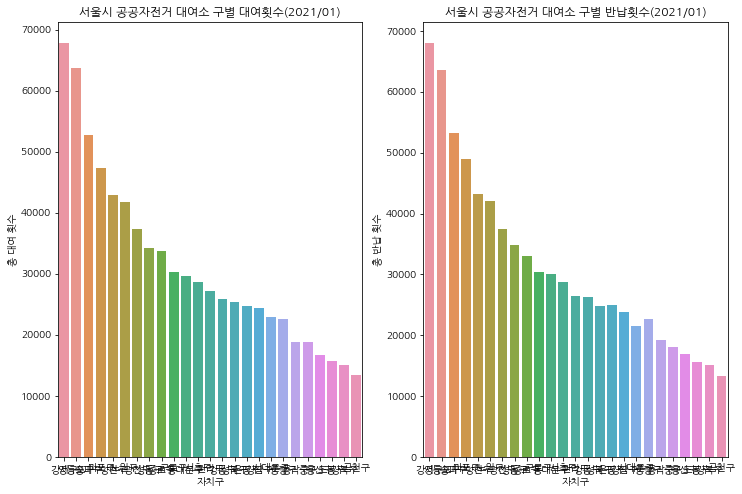

In [197]:
# 구별 총 대여/반납 횟수 시각화

fig = plt.figure(figsize=(12, 8))
area1 = fig.add_subplot(1, 2, 1)
area1.set_title('서울시 공공자전거 대여소 구별 대여횟수(2021/01)')

area2 = fig.add_subplot(1, 2, 2)
area2.set_title('서울시 공공자전거 대여소 구별 반납횟수(2021/01)')

sns.barplot(data=rent_by_ward, x='자치구', y='총 대여 횟수', ax=area1)
sns.barplot(data=rent_by_ward, x='자치구', y='총 반납 횟수', ax=area2)

plt.show()

In [ ]:
rent_by_ward = rent_by_ward.set_index('자치구')
rent_by_ward['이용건수'] = rent_by_ward['총 대여 횟수'] +  rent_by_ward['총 반납 횟수'] 
rent_by_ward

In [231]:
# 어떤 자치구가 가장 활발하게 대여와 반납이 이루어지는가?
import json

map = folium.Map(
    location=[stations['위도'].mean(), stations['경도'].mean()],
    zoom_start=11, 
    tiles='stamentoner'
)
# geo json은 외부에서 가져온 서울시 자치구 지도 json데이터이다.
geo_str = json.load(open('geo.json', encoding='utf-8'))

map.choropleth(
    geo_data=geo_str,
    data=rent_by_ward['이용건수'],
    columns=[rent_by_ward.index, rent_by_ward['이용건수']],
    fill_color='PuRd',
    key_on='feature.id',
    legend_name='이용건수'
)

map

/home/hanoul/.pyenv/versions/3.8.2/envs/week5_eda/lib/python3.8/site-packages/folium/folium.py:409: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [269]:
# 이번엔 각 자치구 내에서도 어떤 대여소들이 가장 많이 사용되는지
# 지도로 시각화해보고자 한다
# 각 대여소별로 대여 빈도수를 히트맵으로 보여줄 것이다.

rent_num = rent[['대여 대여소번호']]
rent_num.columns = ['대여소번호']
new_rent = pd.merge(rent_num, stations, on='대여소번호')
rent_by_stations = new_rent[['대여소번호', '위도', '경도']]
rent_by_stations

,대여소번호,위도,경도
0,101,37.549561,126.905754
1,101,37.549561,126.905754
2,101,37.549561,126.905754
3,101,37.549561,126.905754
4,101,37.549561,126.905754
...,...,...,...
781889,4202,37.546040,126.926727
781890,4202,37.546040,126.926727
781891,4202,37.546040,126.926727
781892,4202,37.546040,126.926727


In [272]:
# 대여소별 대여 히트맵의 분포

from folium.plugins import HeatMap

map = folium.Map(
    location=[stations['위도'].mean(), stations['경도'].mean()],
    zoom_start=11, 
    tiles='stamentoner'
)

heatMap = HeatMap(
    zip(rent_by_stations['위도'], rent_by_stations['경도']),
    min_opacity=0.2,
    radius=15, blur=10,
    max_zoom=5,
    color='red'
)

map.add_child(heatMap)

- 각 자치구 내에서도 한강이나 청계천 등을 중심으로 대여가 자주 발생하고 있음을 알 수 있다.
- 이는 대여 횟수가 비교적 적은 지역이더라도 유사한 결과를 보이고 있다.

## 결론

#### 1.2021년 1월 공공자전거의 대여이력을 확인하여 다음과 같은 결과를 얻었다.
- 1월 총 806503건의 대여/반납이 발생하였다.
- 1월 사용량의 경우 요일별로 사용량에 크게 차이가 나지 않았다.
- 또한 일별 사용량에서 가장 많은 이용량을 나타내는 시간대는 12시 이후부터로, 근무시간이 아닌 시간대였다.
- 이 두 가지 사항으로부터 1월 자전거 이용자가 직장인이 아닌 방학 중의 청소년/대학생/주부 등으로 이루어졌다고 추측하였다.
- 이러한 추론은 실제 이용객 정보를 확인하면 정확히 파악 가능하나, 이번 분석에서는 이를 다루지는 않을 것이다.

#### 2. 서울시 자전거 대여소 정보를 확인하여 다음과 같은 결과를 얻었다.
- 대여소 수/자전거 거치대 수/이용건수는 어느정도 비례 관계에 있었다.
- 자전거 거치대 수/대여소 수/이용건수가 높은 지역들은 주로 한강 및 청계천 등의 인근지역으로 나타났다.
- 위 1번 항목의 분석에서, 자전거 이용자들이 직장인이 아닌 청소년/대학생 등으로 추측한 바 있었다. 위치 데이터로부터 확인한 결과, 회사들이 주로 위치한 지역보다는 강을 위주로 대여 빈도가 높게 형성되었기 때문에 위 추론에 대한 근거로서 채택할 수 있으리라 판단된다.